### **Descripción Lagrangiana del Problema**

El sistema consiste en $ N $ partículas que se mueven dentro de un túnel horizontal de longitud $ L $ y altura $ H $
. Cada partícula tiene una posición definida por su vector de posición $$\mathbf{r}_i(t) = (x_i(t), y_i(t))$$
donde $ i = 1, 2, \dots, N $, y una velocidad $\mathbf{v}_i(t) = (v_{x,i}(t), v_{y,i}(t))$. Las partículas interactúan entre sí mediante colisiones elásticas y con las paredes del túnel según las siguientes reglas:

#### **Ecuaciones de Movimiento**
En ausencia de fuerzas externas (como la gravedad o fricción), las partículas se mueven con velocidad constante entre colisiones. La evolución temporal de la posición y la velocidad de cada partícula está dada por:
$$
\frac{d\mathbf{r}_i}{dt} = \mathbf{v}_i(t),
$$
$$
\frac{d\mathbf{v}_i}{dt} = 0 \quad \text{(sin fuerzas externas)}.
$$

#### **Condiciones de Colisión**
1. **Colisión con las paredes del túnel**:
   - Si una partícula toca la pared inferior ($y_i = 0$), su velocidad se anula: $\mathbf{v}_i(t) = 0.$
   - Si una partícula toca la pared superior ($y_i = H$), su velocidad en $y$ cambia de signo:$v_{y,i}(t^+) = -v_{y,i}(t^-).$
   - Si una partícula toca las paredes laterales ($x_i = 0$ o $x_i = L$), su velocidad en $x$ cambia de signo:$v_{x,i}(t^+) = -v_{x,i}(t^-).$

2. **Colisión entre partículas**:
   Cuando dos partículas $i$ y $j$ colisionan (es decir, cuando la distancia entre ellas es menor que el diámetro efectivo $d$):
   - Se conserva la cantidad de movimiento lineal:
     $$
     m_i \mathbf{v}_i + m_j \mathbf{v}_j = m_i \mathbf{v}_i' + m_j \mathbf{v}_j',
     $$
   - Se conserva la energía cinética total:
     $$
     \frac{1}{2}m_i |\mathbf{v}_i|^2 + \frac{1}{2}m_j |\mathbf{v}_j|^2 = 
     \frac{1}{2}m_i |\mathbf{v}_i'|^2 + \frac{1}{2}m_j |\mathbf{v}_j'|^2.
     $$
   Estas condiciones determinan las velocidades después de la colisión ($\mathbf{v}_i'$ y $\mathbf{v}_j'$).

#### **Restricciones del Sistema**
- El movimiento está restringido al dominio del túnel: $ 0 \leq x_i(t) \leq L, 0 \leq y_i(t) \leq H$.
- Si una partícula toca la pared inferior ($y_i = 0$), se detiene completamente.

---

### **Lagrangiano del Sistema**

El lagrangiano para cada partícula $i$ está dado por: $L_i = T_i - V_i,$ donde:

·) $ T_i = \frac{1}{2}m_i |\mathbf{v}_i|^2 = \frac{1}{2}m_i (v_{x,i}^2 + v_{y,i}^2) $ es la energía cinética.

·) $ V_i = 0$, ya que no hay fuerzas externas actuando sobre las partículas.

El lagrangiano total del sistema es simplemente la suma de los lagrangianos individuales:
$$
L_{\text{total}} = \sum_{i=1}^{N} L_i.
$$

Dado que no hay fuerzas externas ni potenciales, las ecuaciones de Euler-Lagrange para cada coordenada simplemente recuperan las ecuaciones del movimiento rectilíneo uniforme:
$$
\frac{\partial L}{\partial x_i} - \frac{d}{dt}\left(\frac{\partial L}{\partial v_{x,i}}\right) = 0, 
\quad
\frac{\partial L}{\partial y_i} - \frac{d}{dt}\left(\frac{\partial L}{\partial v_{y,i}}\right) = 0.
$$

Animation size has reached 20987968 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


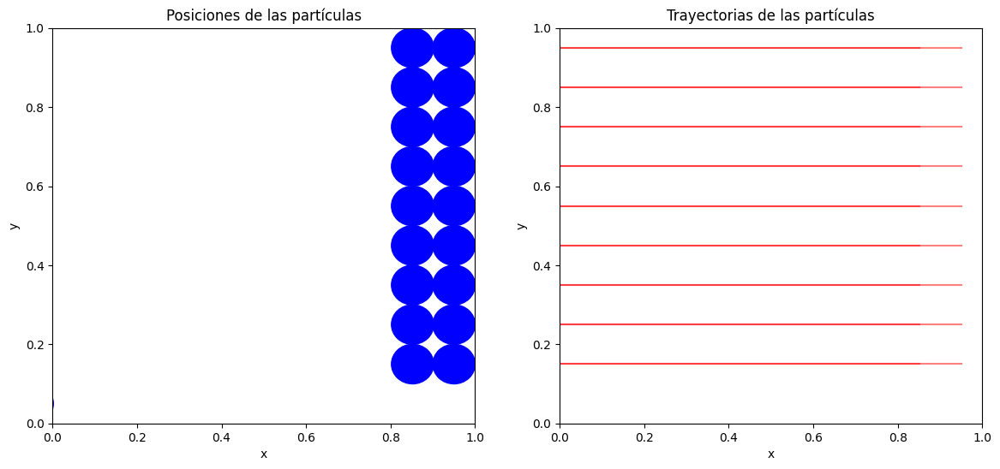

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Parámetros del túnel y las partículas
L = 1.0  # Longitud del túnel (normalizada)
H = 1.0  # Altura del túnel (normalizada)
N = 20   # Número total de partículas
u_0 = 0.2 # Velocidad inicial horizontal (ajustada para el dominio normalizado)
dt = 0.01 # Paso de tiempo
steps = 500 # Número de pasos de simulación
particle_radius = 0.05  # Radio efectivo de las partículas (puedes modificarlo)
num_columns = 2         # Número de columnas de partículas que entran juntas
group_interval = 1.0    # Tiempo entre la entrada de grupos, en segundos

# Inicialización de posiciones y velocidades de las partículas
np.random.seed(42)  # Para reproducibilidad
positions = np.zeros((N, 2))               # Todas las partículas comienzan fuera del túnel
velocities = np.zeros((N, 2))              # Velocidades iniciales (vx, vy)

# Configurar las posiciones iniciales en columnas fuera del túnel (x < 0)
particles_per_column = N // num_columns
for col in range(num_columns):
    start_idx = col * particles_per_column
    end_idx = start_idx + particles_per_column
    positions[start_idx:end_idx, 1] = np.linspace(
        particle_radius, H - particle_radius, particles_per_column
    )
    positions[start_idx:end_idx, 0] = -col * particle_radius * 2 - particle_radius

velocities[:, 0] = u_0                     # Velocidad inicial con componente únicamente horizontal

# Trayectorias para dibujar las líneas
trajectories_x = [[] for _ in range(N)]
trajectories_y = [[] for _ in range(N)]

# Crear la figura para la animación con dos paneles
fig, ax = plt.subplots(1, 2, figsize=(14, 6))

# Panel izquierdo: posiciones actuales de las partículas
ax[0].set_xlim(0, L)
ax[0].set_ylim(0, H)
ax[0].set_title("Posiciones de las partículas")
ax[0].set_xlabel("x")
ax[0].set_ylabel("y")

# Dibujar los círculos para representar las partículas con su radio real
circles = [Circle((positions[i, 0], positions[i, 1]), particle_radius, color='blue') for i in range(N)]
for circle in circles:
    ax[0].add_patch(circle)

# Panel derecho: trayectorias acumuladas de las partículas
ax[1].set_xlim(0, L)
ax[1].set_ylim(0, H)
ax[1].set_title("Trayectorias de las partículas")
ax[1].set_xlabel("x")
ax[1].set_ylabel("y")
trajectory_plots = [ax[1].plot([], [], 'r-', alpha=0.5)[0] for _ in range(N)]  # Trayectorias como líneas rojas

# Función para manejar colisiones elásticas entre partículas
def handle_collisions(positions, velocities):
    for i in range(N):
        for j in range(i + 1, N):
            dist = np.linalg.norm(positions[i] - positions[j])
            if dist < 2 * particle_radius:  # Si las partículas están muy cerca (ajustado al radio)
                normal = (positions[i] - positions[j]) / dist
                relative_velocity = velocities[i] - velocities[j]
                velocity_along_normal = np.dot(relative_velocity, normal)
                if velocity_along_normal < 0:  # Solo manejar colisiones si se acercan entre sí
                    impulse = -2 * velocity_along_normal / 2
                    velocities[i] += impulse * normal
                    velocities[j] -= impulse * normal

# Función para inicializar la animación
def init():
    for line in trajectory_plots:
        line.set_data([], [])
    return trajectory_plots

# Función para actualizar la animación en cada cuadro
def update(frame):
    global positions, velocities
    
    # Actualizar posiciones y velocidades
    positions += velocities * dt
    
    # Manejar colisiones con las paredes del túnel
    for i in range(N):
        if positions[i, 1] <= particle_radius:  # Contacto con la pared inferior (se detiene)
            velocities[i] = [0, 0]
        elif positions[i, 1] >= H - particle_radius:  # Rebote en la pared superior
            velocities[i, 1] *= -1
        
        if positions[i, 0] <= particle_radius and velocities[i][0] < 0:  
            velocities[i][0] *= -1
        
        if positions[i, 0] >= L - particle_radius:  
            velocities[i][0] *= -1
    
    # Manejar colisiones entre partículas
    handle_collisions(positions, velocities)
    
    # Introducir grupos de nuevas partículas en intervalos regulares si están fuera del dominio visible.
    time_elapsed = frame * dt
    if time_elapsed % group_interval < dt:
        for col in range(num_columns):
            start_idx = col * particles_per_column
            end_idx = start_idx + particles_per_column
            
            for i in range(start_idx, end_idx):
                if positions[i][0] < -particle_radius:  
                    positions[i][0] += u_0 * dt

    # Actualizar trayectorias acumuladas y posiciones de los círculos
    for i in range(N):
        trajectories_x[i].append(positions[i, 0])
        trajectories_y[i].append(positions[i, 1])
        circles[i].center = (positions[i, 0], positions[i, 1])  # Actualizar posición del círculo
    
    for i in range(N):
        trajectory_plots[i].set_data(trajectories_x[i], trajectories_y[i])
    
    return trajectory_plots + circles

# Crear la animación usando FuncAnimation de matplotlib
ani = FuncAnimation(fig, update, frames=steps, init_func=init,
                    blit=True, interval=20)

# Mostrar la animación en el notebook usando HTML()
HTML(ani.to_jshtml())


Animation size has reached 21022240 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


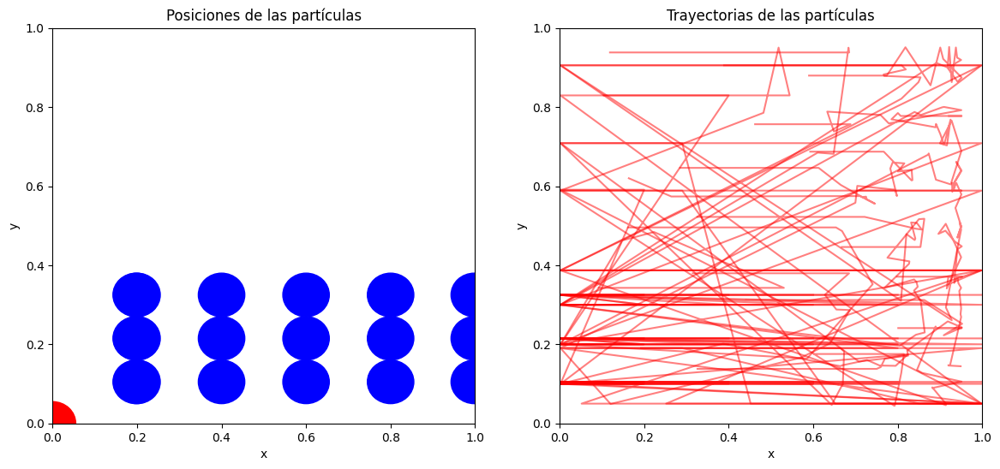

In [27]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Parámetros del túnel y las partículas
L = 1.0  # Longitud del túnel (normalizada)
H = 1.0  # Altura del túnel (normalizada)
N = 20   # Número máximo de partículas simultáneamente en el túnel
u_0 = 0.2 # Velocidad inicial horizontal (ajustada para el dominio normalizado)
dt = 0.01 # Paso de tiempo
steps = 500 # Número de pasos de simulación
particle_radius = 0.055  # Radio efectivo de las partículas (puedes modificarlo)
group_interval = 1.0    # Tiempo entre la entrada de grupos, en segundos

# Inicialización de posiciones y velocidades de las partículas
np.random.seed(42)  # Para reproducibilidad
positions = np.zeros((N, 2)) - 10.0      # Inicialmente todas las partículas están fuera del túnel
velocities = np.zeros((N, 2))            # Velocidades iniciales (vx, vy)
active_particles = np.zeros(N, dtype=bool)  # Estado activo/inactivo de cada partícula

# Partícula fija en (x, y) = (0, 0)
fixed_particle_position = [0, 0]

# Crear la figura para la animación con dos paneles
fig, ax = plt.subplots(1, 2, figsize=(14, 6))

# Panel izquierdo: posiciones actuales de las partículas
ax[0].set_xlim(0, L)
ax[0].set_ylim(0, H)
ax[0].set_title("Posiciones de las partículas")
ax[0].set_xlabel("x")
ax[0].set_ylabel("y")

# Dibujar la partícula fija en (x=0, y=0)
fixed_circle = Circle(fixed_particle_position, particle_radius, color='red')
ax[0].add_patch(fixed_circle)

# Dibujar los círculos para representar las partículas con su radio real
circles = [Circle((positions[i, 0], positions[i, 1]), particle_radius, color='blue') for i in range(N)]
for circle in circles:
    ax[0].add_patch(circle)

# Panel derecho: trayectorias acumuladas de las partículas
ax[1].set_xlim(0, L)
ax[1].set_ylim(0, H)
ax[1].set_title("Trayectorias de las partículas")
ax[1].set_xlabel("x")
ax[1].set_ylabel("y")
trajectory_plots = [ax[1].plot([], [], 'r-', alpha=0.5)[0] for _ in range(N)]  # Trayectorias como líneas rojas

# Función para generar nuevas tandas de partículas en x=0
def generate_new_particles(positions, velocities, active_particles):
    for i in range(3):  # Generar un grupo de tres partículas
        idx = np.where(active_particles == False)[0]  # Buscar índices inactivos
        if len(idx) > i:  # Si hay espacio para nuevas partículas
            idx = idx[i]
            y_position = particle_radius + 0.05 + i * (2 * particle_radius)  # Separación vertical entre centros
            positions[idx] = [0, y_position]         # Colocar la partícula en x=0 con separación vertical
            velocities[idx] = [u_0, 0]              # Asignar velocidad inicial horizontal
            active_particles[idx] = True           # Activar la partícula

# Función para manejar colisiones elásticas entre partículas activas
def handle_collisions(positions, velocities):
    for i in range(N):
        if not active_particles[i]:
            continue
        
        for j in range(i + 1, N):
            if not active_particles[j]:
                continue
            
            dist = np.linalg.norm(positions[i] - positions[j])
            if dist < 2 * particle_radius:  # Si las partículas están muy cerca (ajustado al radio)
                normal = (positions[i] - positions[j]) / dist
                relative_velocity = velocities[i] - velocities[j]
                velocity_along_normal = np.dot(relative_velocity, normal)
                if velocity_along_normal < 0:  # Solo manejar colisiones si se acercan entre sí
                    
                    impulse = -2 * velocity_along_normal / (2) 
                    velocities[i] += impulse * normal
                    
                    velocities[j] -= impulse * normal

# Función para inicializar la animación
def init():
    for line in trajectory_plots:
        line.set_data([], [])
    return trajectory_plots

# Función para actualizar la animación en cada cuadro
def update(frame):
    global positions, velocities
    
    time_elapsed = frame * dt
    
    # Generar nuevas partículas periódicamente según group_interval
    if time_elapsed % group_interval < dt:
        generate_new_particles(positions, velocities, active_particles)
    
    # Actualizar posiciones y velocidades de las partículas activas
    for i in range(N):
        if active_particles[i]:
            positions[i] += velocities[i] * dt
            
            # Eliminar partículas que salen del túnel (x > L)
            if positions[i][0] > L:
                active_particles[i] = False
    
    # Manejar colisiones entre partículas activas
    handle_collisions(positions, velocities)

    # Actualizar trayectorias acumuladas y posiciones de los círculos activos
    for i in range(N):
        if active_particles[i]:
            trajectories_x[i].append(positions[i][0])
            trajectories_y[i].append(positions[i][1])
            circles[i].center = (positions[i][0], positions[i][1]) 
    
    for i in range(N):
        trajectory_plots[i].set_data(trajectories_x[i], trajectories_y[i])
    
    return trajectory_plots + circles

# Crear la animación usando FuncAnimation de matplotlib
ani = FuncAnimation(fig, update, frames=steps,
                    init_func=init,
                    blit=True,
                    interval=20)

# Mostrar la animación en el notebook usando HTML()
HTML(ani.to_jshtml())
